In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import LineString
import os
from scipy.spatial import cKDTree
import networkx as nx
import momepy
from libpysal import weights
import osmnx as ox
import requests
import contextily as ctx

# US Road Network

we first need a shapefile that is the road network of united states.  
we then turn that into a graph.  

## OSM road network

In [365]:
from shapely.geometry import MultiLineString

def explode_multilinestrings(gdf):
    rows = []
    for idx, row in gdf.iterrows():
        if isinstance(row.geometry, MultiLineString):
            # If the geometry is a MultiLineString, split it into LineStrings
            for linestring in row.geometry.geoms:
                new_row = row.copy()
                new_row.geometry = linestring
                rows.append(new_row)
        else:
            # If the geometry is not a MultiLineString, just add it to the list
            rows.append(row)

    # Create a new GeoDataFrame from the list of rows
    new_gdf = gpd.GeoDataFrame(rows, columns=gdf.columns).set_geometry('geometry')

    return new_gdf

In [44]:
us_poly = gpd.read_file('tiger/nation/cb_2018_us_nation_20m/cb_2018_us_nation_20m.shp')

us_primary_raods = gpd.read_file(r'tiger\tl_2022_us_primaryroads\tl_2022_us_primaryroads.shp')
us_primary_raods['length'] = us_primary_raods.length

# nationgeo = gpd.read_file('tlgdb_2015_a_us_nationgeo.gdb/tlgdb_2015_a_us_nationgeo.gdb')
roads = gpd.read_file('tlgdb_2015_a_us_roads.gdb/tlgdb_2015_a_us_roads.gdb')
# substate = gpd.read_file('tlgdb_2015_a_us_substategeo.gdb/tlgdb_2015_a_us_substategeo.gdb')

roads_sub = roads[roads['RTTYP'].isin(['I', 'M'])]
roads_sub.reset_index(inplace=True, drop=True)
roads_sub['length'] = roads_sub.length
roads_sub['centroid_x'] = roads_sub['geometry'].centroid.x
roads_sub['centroid_y'] = roads_sub['geometry'].centroid.y
roads_sub = roads_sub[(roads_sub['centroid_x'] <-65) & (roads_sub['centroid_x'] >-125) & (roads_sub['centroid_y'] <49.1) & (roads_sub['centroid_y'] >24)]
roads_sub = roads_sub[roads_sub['length'] > 0.1]
roads_sub.reset_index(inplace=True, drop=True)

In [311]:
def convert_shp2graph(gdf, make_G_bidi = True, name='unamed', default_speed_kph=113):
    """
    Converts shapefile to routable networkx graph.
    
    Parameters
    ----------
    gdf : file , File path - allowed formats geojson and ESRI Shapefile and other formats Fiona can read and write
    make_G_bidi : bool, if True, assumes linestrings are bidirectional
    name : str, Optional name of graph
    
    Returns
    -------
    G : graph
    """
    
    
    # Load shapefile into GeoDataFrame
    # gdf = gp.read_file(p)
    
    # shapefile needs to include minimal: geometry linestring and the length computed (e.g. in QGIS)
    if 'length' not in gdf.columns:
        raise Exception('Shapefile is invalid: length not in attributes:\n{}'.format(gdf.columns))

    if  not gdf.geometry.map(lambda x: type(x) ==  LineString).all():
        s_invalid_geo = gdf.geometry[gdf.geometry.map(lambda x: type(x) ==  LineString)]
        raise Exception('Shapefile is invalid: geometry not all linestring \n{}'.format(s_invalid_geo))
   
    # Compute the start- and end-position based on linestring 
    gdf['Start_pos'] = gdf.geometry.apply(lambda x: x.coords[0])
    gdf['End_pos'] = gdf.geometry.apply(lambda x: x.coords[-1])
    
    # Create Series of unique nodes and their associated position
    s_points = gdf.Start_pos.append(gdf.End_pos).reset_index(drop=True)
    s_points = s_points.drop_duplicates()   
#     log('GeoDataFrame has {} elements (linestrings) and {} unique nodes'.format(len(gdf),len(s_points)))
    
    # Add index of start and end node of linestring to geopandas DataFrame
    df_points = pd.DataFrame(s_points, columns=['Start_pos'])
    df_points['FNODE_'] = df_points.index
    gdf = pd.merge(gdf, df_points, on='Start_pos', how='inner')

    df_points = pd.DataFrame(s_points, columns=['End_pos'])
    df_points['TNODE_'] = df_points.index
    gdf = pd.merge(gdf, df_points, on='End_pos', how='inner')
    
    # Bring nodes and their position in form needed for osmnx (give arbitrary osmid (index) despite not osm file)
    df_points.columns = ['pos', 'osmid_arb'] 
    df_points[['x', 'y']] = df_points['pos'].apply(pd.Series)
    df_node_xy = df_points.drop('pos', 1)
    
    # Create Graph Object
    G = nx.MultiDiGraph(name=name, crs=gdf.crs)
    
    # Add nodes to graph
    for node, data in df_node_xy.T.to_dict().items():
        G.add_node(node, **data)
        
    # Add edges to graph
    for i, row in gdf.iterrows():
        dict_row = row.to_dict()
        if 'geometry' in dict_row:
            del dict_row['geometry']

        # Ensure length is present and calculated
        if 'length' not in dict_row or pd.isna(dict_row['length']):
            if 'geometry' in row:
                # Calculate length in meters
                dict_row['length'] = row['geometry'].length
            else:
                raise ValueError("Edge length is missing and cannot be calculated.")

        # Ensure speed is present
        dict_row.setdefault('speed_kph', default_speed_kph)

        G.add_edge(dict_row['FNODE_'], dict_row['TNODE_'], **dict_row)
        
    if make_G_bidi:
        gdf.rename(columns={'Start_pos': 'End_pos',
                   'End_pos': 'Start_pos',
                   'FNODE_': 'TNODE_', 
                   'TNODE_': 'FNODE_', }, inplace=True)
        
        # Add edges to graph
        for i, row  in gdf.iterrows():
            dict_row  = row.to_dict()
            if 'geometry' in dict_row: del dict_row['geometry']
            dict_row['speed_kph'] = default_speed_kph  # Add default speed to each edge
            G.add_edge(dict_row['FNODE_'], dict_row['TNODE_'], **dict_row)
        
#         G = G.to_undirected() # Some function in osmnx do not work anymore
        
    # Log information
#     log('Graph has been successfully generated /n {}'.format(nx.info(G)))
#     log('Show graph data structure EDGE'.format(G.get_edge_data(*list(G.edges())[0])))
#     log('Show graph data structure NODE'.format(list(G.nodes())[0]))
    return G

In [313]:
g = convert_shp2graph(us_primary_raods)

G = ox.simplify_graph(g)
G_projected = ox.project_graph(G)
G = ox.simplification.consolidate_intersections(G_projected,tolerance=5,rebuild_graph=True, reconnect_edges=True) # consolidate the intersections
G = ox.add_edge_travel_times(G)

# ox.save_graphml(G, filepath = "us_roadnetwork/us_interstate_road_network_graph.graphml")
# ox.save_graph_xml(G, filepath = "us_roadnetwork/us_interstate_road_network_graph.xml")

In [318]:
g = G.copy()
g.remove_nodes_from(list(nx.isolates(g)))
subgraphs = list(nx.connected_components(g.to_undirected()))
largest_subgraph = max(subgraphs, key=len)
city_graph = g.subgraph(largest_subgraph).copy()
G1 = ox.utils_graph.get_largest_component(city_graph, strongly=True)
# ox.save_graphml(G1, filepath = "us_roadnetwork/us_interstate_road_network_graph_simplified.graphml")
# ox.save_graph_xml(G1, filepath = "us_roadnetwork/us_interstate_road_network_graph_simplified.xml")

In [417]:
def initial_graph(road_shp):
    g = convert_shp2graph(road_shp)
    G = ox.simplify_graph(g)
    G_projected = ox.project_graph(G)
    G = ox.simplification.consolidate_intersections(G_projected,tolerance=5,rebuild_graph=True, reconnect_edges=True) # consolidate the intersections
    G = ox.add_edge_travel_times(G)
    return G

def simplified_graph(G):
    g = G.copy()
    g.remove_nodes_from(list(nx.isolates(g)))
    subgraphs = list(nx.connected_components(g.to_undirected()))
    largest_subgraph = max(subgraphs, key=len)
    city_graph = g.subgraph(largest_subgraph).copy()
    G1 = ox.utils_graph.get_largest_component(city_graph, strongly=True)
    return G1

In [415]:
roads_sub_ls = explode_multilinestrings(roads_sub)
roads_sub_ls = roads_sub_ls.drop_duplicates(subset=['LINEARID'])
roads_sub_ls.reset_index(inplace=True, drop=True)
roads_sub_ls.set_crs(epsg=4269, inplace=True)

G3 = initial_graph(roads_sub_ls)
# simplified_G3 = simplified_graph(G3)
# ox.save_graphml(G3, filepath = "us_roadnetwork/us_main_interstate_road_network_graph.graphml")
# ox.save_graph_xml(G3, filepath = "us_roadnetwork/us_main_interstate_road_network_graph.xml")

C:\Users\hgazmeh\AppData\Local\Temp\2\ipykernel_1152\2815921539.py:33: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  s_points = gdf.Start_pos.append(gdf.End_pos).reset_index(drop=True)
C:\Users\hgazmeh\AppData\Local\Temp\2\ipykernel_1152\2815921539.py:49: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_node_xy = df_points.drop('pos', 1)
c:\Users\hgazmeh\Anaconda3\envs\ox\Lib\site-packages\osmnx\utils_graph.py:88: FutureWarning: You are adding a column named 'geometry' to a GeoDataFrame constructed without an active geometry column. Currently, this automatically sets the active geometry column to 'geometry' but in the future that will no longer happen. Instead, either provide geometry to the GeoDataFrame constructor (GeoDataFrame(... geometry=GeoSeries()) or use `set_geometry('geometry')` to explicitly set the 

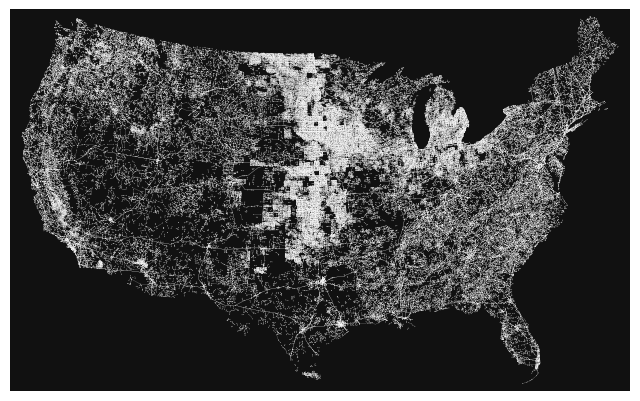

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [400]:
ox.plot_graph(G3, edge_linewidth=0.1, node_size=0.2)

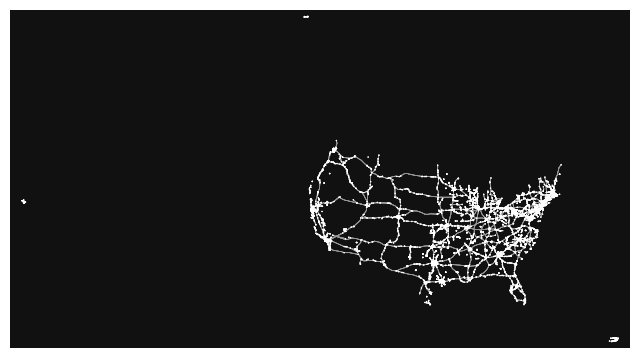

In [317]:
fig, ax = ox.plot_graph(G, node_size=1, edge_linewidth=0.5, edge_alpha=1)

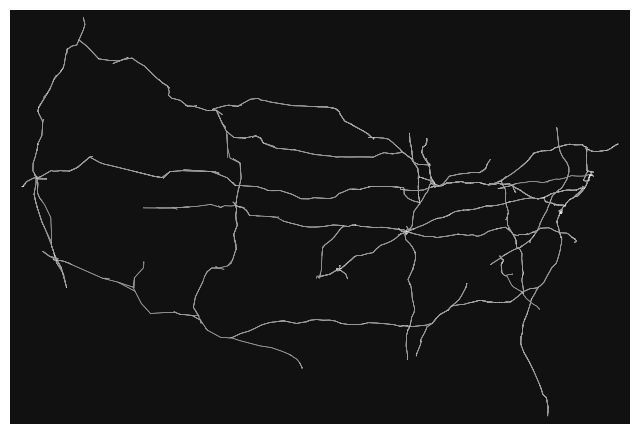

In [320]:
fig, ax = ox.plot_graph(G1, node_size=0.1, edge_linewidth=0.5, edge_alpha=1)

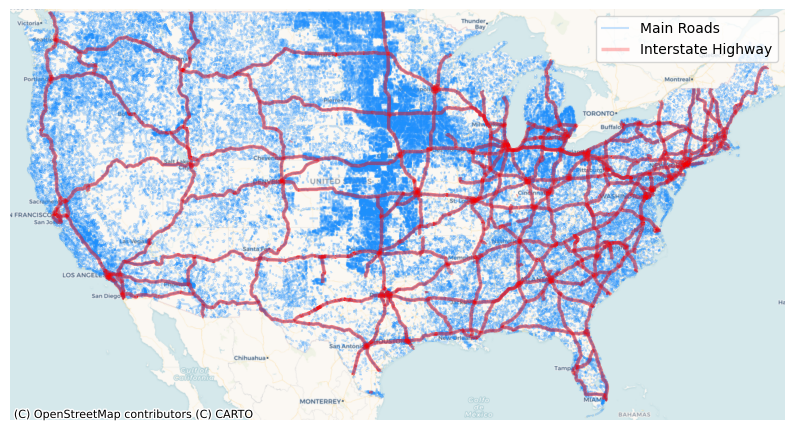

In [359]:
# map the roads using contexily 
import contextily as ctx

primary_adds = roads_sub.to_crs(epsg=3857) # us_primary_raods, roads[roads['RTTYP'] == 'I'] 
primary_adds_i = roads[roads['RTTYP'] == 'I'].to_crs(epsg=3857)
# stops = stops.to_crs(epsg=3857)
fig, ax = plt.subplots(figsize=(10, 10))
primary_adds.plot(ax=ax, color='dodgerblue', alpha=0.25, label='Main Roads', linewidth=1.5)
primary_adds_i.plot(ax=ax, color='red', alpha=0.25, label='Interstate Highway', linewidth=2.5)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager)
ax.set_axis_off()
ax.legend()
# add a xlim and ylim to zoom in the map
ax.set_xlim([-1.4e7, -0.74e7])
ax.set_ylim([2.8e6, 6.3e6])
# save the figure
# plt.savefig('us_main_interstate_roads.png', dpi=1200, bbox_inches='tight')
# plt.savefig('us_main_interstate_roads.pdf')

an example of a router

In [109]:
# from pyroutelib3 import Router # Import the router
# router = Router("car") # Initialise it
# # router = Router("car", "arkansas-latest.osm.bz2", localfileType="bz2")

# start = router.findNode(33.21405459282745, -87.5543052478714) # Find start and end nodes
# end = router.findNode(33.22080433384824, -87.53636663568956)

# status, route = router.doRoute(start, end) # Find the route - a list of OSM nodes

# if status == 'success':
#     routeLatLons = list(map(router.nodeLatLon, route)) # Get actual route coordinates

# Prepare the Data

### FACILITIES

In [25]:
# landfill_trans = pd.read_csv('Transfer Station.csv')
# # landfill_trans = landfill_trans[['Latitude','Longitude','Landfill','Transfer Station','DDRT_ID','x','y']]
# landfill_trans = landfill_trans.dropna(subset=['Latitude', 'Longitude'])
# landfill_trans.drop_duplicates(subset=['Latitude', 'Longitude'], inplace=True)
# landfill_trans.reset_index(inplace=True, drop=True)
# # add a id column
# landfill_trans['landfill_trans_id'] = landfill_trans.index + 1 
# # create a geodataframe from the landfill
# landfill_trans_gdf = gpd.GeoDataFrame(landfill_trans, geometry=gpd.points_from_xy(landfill_trans.Longitude, landfill_trans.Latitude), crs='EPSG:4269')
# landfill_trans_gdf['x'] = landfill_trans_gdf.geometry.x
# landfill_trans_gdf['y'] = landfill_trans_gdf.geometry.y

# waste_transfer_stations = landfill_trans_gdf[landfill_trans_gdf['Landfill'] == 'No']
# waste_transfer_stations.reset_index(inplace=True, drop=True)

waste_transfer_stations = pd.read_csv('WTS_FINAL.csv')

In [26]:
for year in range(1990, 2061):
    landfill = pd.read_csv('lanfill_FINAL.csv')
    before = landfill[landfill['Year Landfill Opened'] > year]
    after = landfill[landfill['Landfill Closure Year'] < year]
    landfill = landfill.drop(before.index)
    landfill = landfill.drop(after.index)
    landfill = landfill.dropna(subset=['Latitude', 'Longitude'])
    landfill.drop_duplicates(subset=['Latitude', 'Longitude'], inplace=True)
    landfill.reset_index(inplace=True, drop=True)
    landfill_gdf = gpd.GeoDataFrame(landfill, geometry=gpd.points_from_xy(landfill.Longitude, landfill.Latitude), crs='EPSG:4269')
    landfill_gdf['x'] = landfill_gdf.geometry.x
    landfill_gdf['y'] = landfill_gdf.geometry.y

    landfill_gdf_sub = landfill_gdf[['Latitude', 'Longitude', 'Landfill ID']]

    waste_transfer_stations['facility_id'] = waste_transfer_stations['DDRT_ID']
    waste_transfer_stations['facility_label'] = 'WTS'
    landfill_gdf_sub['facility_id'] = landfill_gdf_sub['Landfill ID']
    landfill_gdf_sub['facility_label'] = 'MLF'
    all_facilities = pd.concat([waste_transfer_stations[['Latitude', 'Longitude', 'facility_id', 'facility_label']], landfill_gdf_sub[['Latitude', 'Longitude', 'facility_id', 'facility_label']]], axis=0)
    all_facilities = gpd.GeoDataFrame(all_facilities, geometry=gpd.points_from_xy(all_facilities.Longitude, all_facilities.Latitude), crs='EPSG:4269')
    all_facilities.reset_index(inplace=True, drop=True)

    all_facilities['facility_x'] = all_facilities.geometry.x
    all_facilities['facility_y'] = all_facilities.geometry.y    
    all_facilities.to_file('Allocation to Census tracts_v3/all_facilities/all_facilities_{}.geojson'.format(year), driver='GeoJSON')
    all_facilities.to_csv('Allocation to Census tracts_v3/all_facilities/all_facilities_{}.csv'.format(year))

C:\Users\hgazmeh\AppData\Local\Temp\2\ipykernel_348\2634058332.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  landfill_gdf_sub['facility_id'] = landfill_gdf_sub['Landfill ID']
C:\Users\hgazmeh\AppData\Local\Temp\2\ipykernel_348\2634058332.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  landfill_gdf_sub['facility_label'] = 'MLF'
C:\Users\hgazmeh\AppData\Local\Temp\2\ipykernel_348\2634058332.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using

In [189]:
if year >= 2020:
    tiger_year = 2020

tiger_tracts = gpd.read_file('tiger_tracts_{}.geojson'.format(year))
tiger_tracts = tiger_tracts[['GEOID', 'geometry']]

In [200]:
# os.listdir('Allocation to Census tracts_v3/Allocation to Census tracts_v3')

scenarios_dir_list = ['01_CTAccuYear_High_StatusQuo',
 '02_CTAccuYear_Low_StatusQuo',
 '03_CTAccuYear_High_Recycling',
 '04_CTAccuYear_Low_Recycling',
 '05_CTAccuYear_High_PhaseOut',
 '06_CTAccuYear_Low_PhaseOut',
 '07_CTVolumeYear_StatusQuo',
 '08_CTVolumeYear_Recycling',
 '09_CTVolumeYear_PhaseOut'] 
scenario = scenarios_dir_list[0]

In [323]:
from ct_to_facility_ods5 import osm_processing

In [418]:
ct_facility_ods = osm_processing(pfas_gdf, all_facilities, G3)

d:\Users\hgazmeh\Codes\pfas\ct_to_facility_ods5.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_pcs['GEOID'] = row['GEOID']
d:\Users\hgazmeh\Codes\pfas\ct_to_facility_ods5.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_pcs['GEOID'] = row['GEOID']
d:\Users\hgazmeh\Codes\pfas\ct_to_facility_ods5.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http

In [420]:
ct_facility_ods

,facility_id,facility_x,facility_y,GEOID,ct_x,ct_y,closest_origin_node,closest_destination_node,travel_time_sec
0,2409.0,-86.740500,32.928500,01001020100,-86.490069,32.477185,18039,7182,inf
1,11581.0,-85.831100,32.515400,01001020100,-86.490069,32.477185,18039,77031,inf
2,10860.0,-87.468500,32.413000,01001020100,-86.490069,32.477185,18039,38316,inf
3,2409.0,-86.740500,32.928500,01001020200,-86.473374,32.474345,37734,7182,inf
4,11581.0,-85.831100,32.515400,01001020200,-86.473374,32.474345,37734,77031,inf
...,...,...,...,...,...,...,...,...,...
253237,e74b8702-f1e1-47dc-8ec6-743c9e7b8781,-105.515983,44.284298,56045951100,-104.573530,43.840148,43695,50553,inf
253238,2466253d-34ec-4012-94b2-0b50d292761c,-104.456428,42.775479,56045951100,-104.573530,43.840148,43695,62807,inf
253239,a9fbf650-b352-41a8-a165-f04fb3eac190,-104.380449,44.405498,56045951300,-104.254377,43.859037,94407,5491,inf
253240,f0cacc3a-ea96-4b7f-b8f9-a3dbabe2f38d,-103.478093,43.432614,56045951300,-104.254377,43.859037,94407,12287,inf


### Get the road network for regions

In [39]:
def get_graph(shp_geometry): 
    cf = '["highway"~"primary"]'# '["highway"~"primary|secondary"]'# '["highway"~"primary|secondary|motorway_link|primary_link|trunk|motorway|trunk_link|secondary_link"]' #'["highway"~"motorway|motorway_link"]'
    region_g = ox.graph_from_polygon(shp_geometry, network_type='drive', simplify=True, retain_all=False, truncate_by_edge=True, clean_periphery=None, custom_filter=cf)
    return region_g

def get_graph_place(name_place): 
    cf = '["highway"~"primary|motorway"]'# '["highway"~"primary|secondary"]'# '["highway"~"primary|secondary|motorway_link|primary_link|trunk|motorway|trunk_link|secondary_link"]' #'["highway"~"motorway|motorway_link"]'
    region_g = ox.graph_from_place(name_place, network_type='drive', simplify=True, retain_all=False, truncate_by_edge=True, clean_periphery=None, custom_filter=cf)
    return region_g

def remove_non_intersections(graph):
    degrees = graph.degree()
    non_intersections = [node for node, degree in degrees if degree <= 2]
    graph.remove_nodes_from(non_intersections)
    return graph

def make_graph_simply(region_g):
    hwy_speeds = {'motorway': 70,
                'trunk': 70,
                'primary': 60,
                'residential': 40,
                'tertiary': 40}
    G_projected = ox.project_graph(region_g)
    G_projected = remove_non_intersections(G_projected)
    G_projected = ox.simplification.consolidate_intersections(G_projected,tolerance=5,rebuild_graph=True, reconnect_edges=True, dead_ends=True) # consolidate the intersections
    G_projected = ox.add_edge_speeds(G_projected, hwy_speeds)
    G_projected = ox.add_edge_travel_times(G_projected)
    city_graph = remove_non_intersections(G_projected)
    city_graph.remove_nodes_from(list(nx.isolates(city_graph)))
    subgraphs = list(nx.connected_components(city_graph.to_undirected()))
    largest_subgraph = max(subgraphs, key=len)
    city_graph = city_graph.subgraph(largest_subgraph).copy()
    return city_graph

In [3]:
regions_gdf = gpd.read_file('tiger/regions/cb_2018_us_region_20m/cb_2018_us_region_20m.shp')
regions_gdf.to_crs(epsg=4326, inplace=True)

for idx, row in regions_gdf.iterrows():
    region_g = get_graph(row.geometry)
    city_graph = make_graph_simply(region_g)
    ox.save_graphml(city_graph, filepath = "us_roadnetwork/regions_graph/region_{}_graph.graphml".format(row['NAME']))
    ox.save_graph_xml(city_graph, filepath = "us_roadnetwork/regions_graph/region_{}_graph.xml".format(row['NAME']))

c:\Users\hgazmeh\Anaconda3\envs\ox\Lib\site-packages\osmnx\graph.py:488: UserWarning: the graph-level street_count attribute will likely be inaccurate when you set clean_periphery=False
  warnings.warn(msg)
c:\Users\hgazmeh\Anaconda3\envs\ox\Lib\site-packages\osmnx\osm_xml.py:187: UserWarning: In order for save_graph_xml to behave properly the graph must have been created with the `all_oneway` setting set to True.
  warnings.warn(msg)
c:\Users\hgazmeh\Anaconda3\envs\ox\Lib\site-packages\osmnx\graph.py:488: UserWarning: the graph-level street_count attribute will likely be inaccurate when you set clean_periphery=False
  warnings.warn(msg)
c:\Users\hgazmeh\Anaconda3\envs\ox\Lib\site-packages\osmnx\osm_xml.py:187: UserWarning: In order for save_graph_xml to behave properly the graph must have been created with the `all_oneway` setting set to True.
  warnings.warn(msg)


In [44]:
alabama_g = get_graph_place('Alabama, USA')
california_g = get_graph_place('California, USA')

c:\Users\hgazmeh\Anaconda3\envs\ox\Lib\site-packages\osmnx\graph.py:488: UserWarning: the graph-level street_count attribute will likely be inaccurate when you set clean_periphery=False
  warnings.warn(msg)


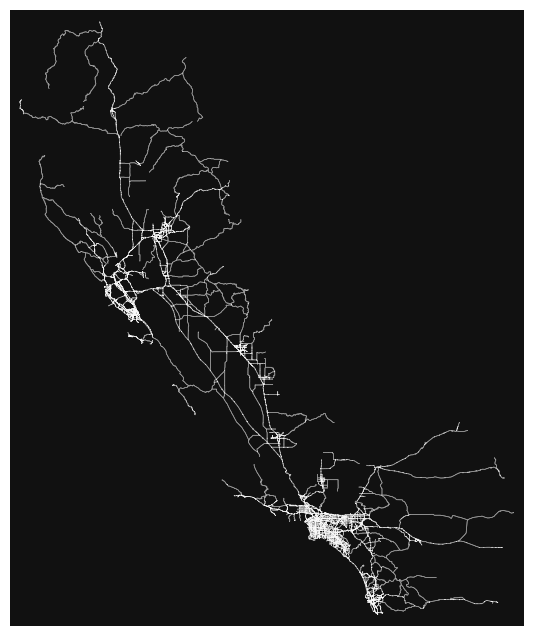

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [45]:
ox.plot_graph(california_g, node_size=0.1, edge_linewidth=0.5, edge_alpha=1)

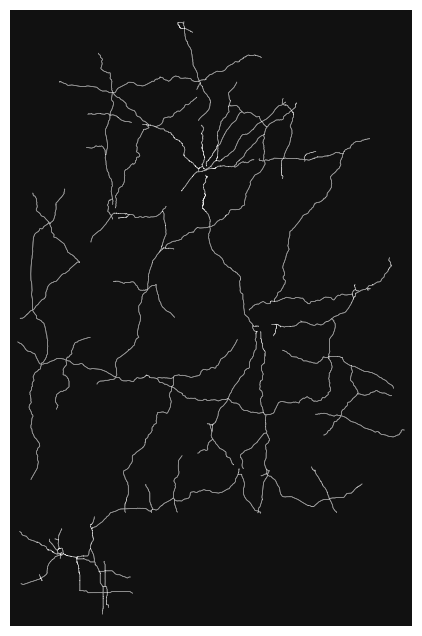

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [27]:
ox.plot_graph(alabama_g, node_size=0.1, edge_linewidth=0.5, edge_alpha=1)

In [11]:
regions_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### sample graph for state of AL

In [41]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(alabama_g)

In [42]:
gdf_edges['highway'].value_counts()

primary                          4074
motorway_link                    2647
primary_link                     1653
motorway                         1419
[primary, motorway_link]           20
[motorway_link, motorway]          11
[primary, motorway]                 9
[primary, primary_link]             7
[motorway_link, primary_link]       1
Name: highway, dtype: int64

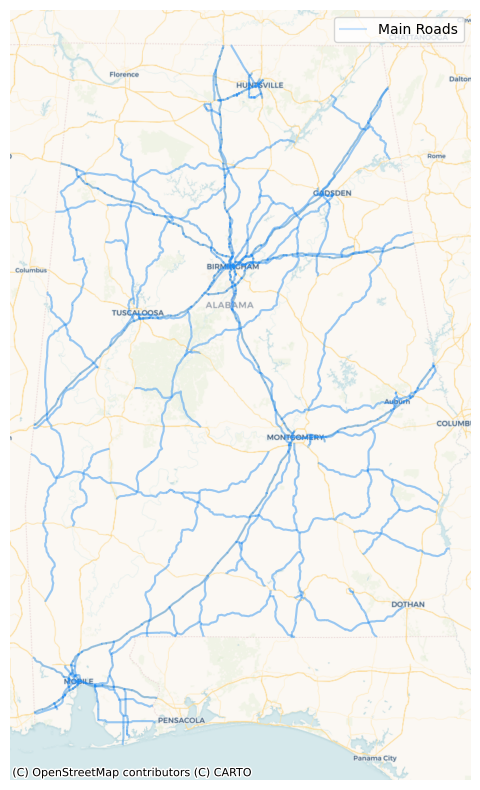

In [43]:
primary_adds = gdf_edges.to_crs(epsg=3857) # us_primary_raods, roads[roads['RTTYP'] == 'I'] 
# stops = stops.to_crs(epsg=3857)
fig, ax = plt.subplots(figsize=(10, 10))
primary_adds.plot(ax=ax, color='dodgerblue', alpha=0.25, label='Main Roads', linewidth=1.5)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Voyager)
ax.set_axis_off()
ax.legend()
# add a xlim and ylim to zoom in the map
# ax.set_xlim([-1.4e7, -0.74e7])
# ax.set_ylim([2.8e6, 6.3e6])